In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib

Using matplotlib backend: module://matplotlib_inline.backend_inline


In [3]:
students = pd.read_csv("student_lifestyle_dataset.csv")

stress_mapping = {"High": 3, "Moderate": 2, "Low": 1}
students["Stress_Score"] = students["Stress_Level"].map(stress_mapping)
numeric_columns = students.select_dtypes(include=['number'])
if 'Student_ID' in numeric_columns.columns:
    numeric_columns = numeric_columns.drop(columns=['Student_ID'])
    

**Check the head of the dataframe.**

In [6]:
print(students.head())


   Student_ID  Study_Hours_Per_Day  Extracurricular_Hours_Per_Day  \
0           1                  6.9                            3.8   
1           2                  5.3                            3.5   
2           3                  5.1                            3.9   
3           4                  6.5                            2.1   
4           5                  8.1                            0.6   

   Sleep_Hours_Per_Day  Social_Hours_Per_Day  Physical_Activity_Hours_Per_Day  \
0                  8.7                   2.8                              1.8   
1                  8.0                   4.2                              3.0   
2                  9.2                   1.2                              4.6   
3                  7.2                   1.7                              6.5   
4                  6.5                   2.2                              6.6   

    GPA Stress_Level  Stress_Score  
0  2.99     Moderate             2  
1  2.75          Low    

# EDA

Since this data is artificial, we'll just do a large pairplot with seaborn.

**Use seaborn on the dataframe to create a pairplot with the hue indicated by the TARGET CLASS column.**

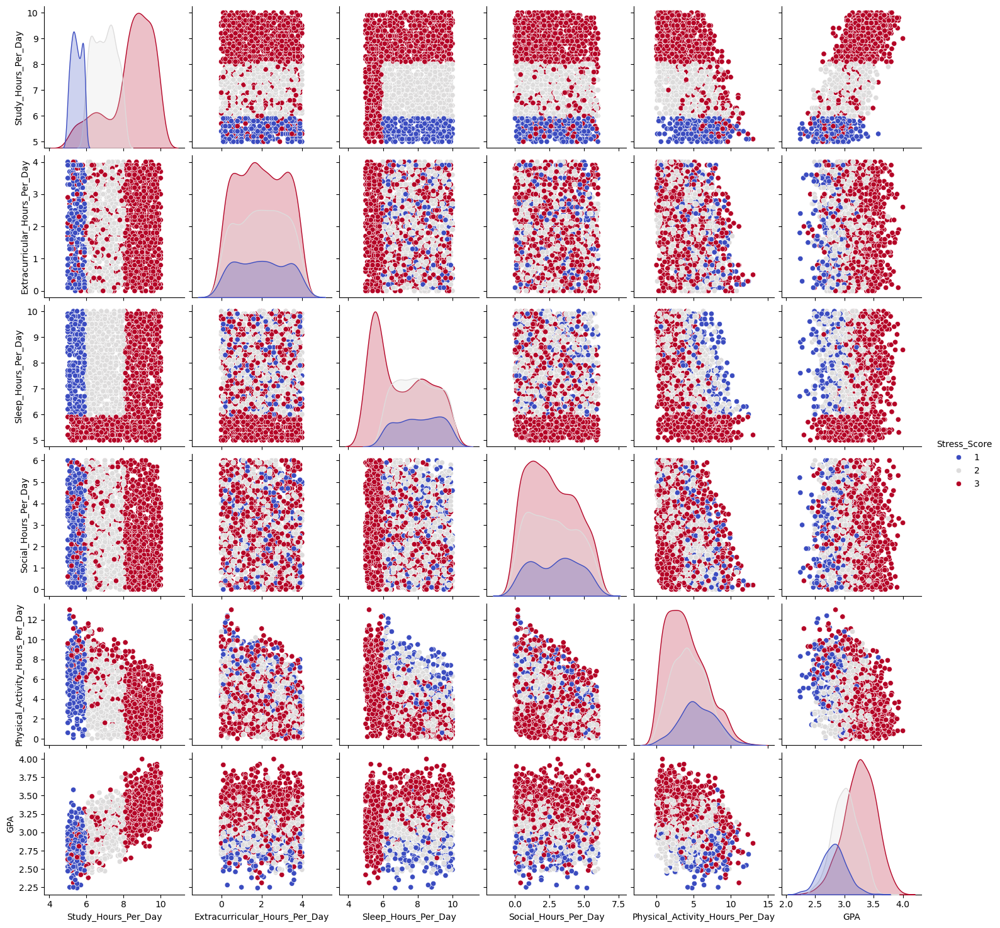

In [9]:
g = sns.pairplot(numeric_columns, hue = 'Stress_Score', palette='coolwarm')
plt.show()


# Standardize the Variables

Time to standardize the variables.

** Import StandardScaler from Scikit learn.**

In [12]:
from sklearn.preprocessing import StandardScaler


** Create a StandardScaler() object called scaler.**

In [15]:
scaler = StandardScaler()
scaler.fit(numeric_columns.drop('Stress_Score',axis=1))

StandardScaler()

** Fit scaler to the features.**

**Use the .transform() method to transform the features to a scaled version.**

In [19]:
scaled_features = scaler.transform(numeric_columns.drop('Stress_Score',axis=1))

**Convert the scaled features to a dataframe and check the head of this dataframe to make sure the scaling worked.**

In [22]:
df_feat = pd.DataFrame(scaled_features,columns=numeric_columns.columns[:-1])
df_feat.head()

,Study_Hours_Per_Day,Extracurricular_Hours_Per_Day,Sleep_Hours_Per_Day,Social_Hours_Per_Day,Physical_Activity_Hours_Per_Day,GPA
0,-0.404487,1.566246,0.820734,0.056543,-1.005896,-0.421837
1,-1.528451,1.306633,0.341473,0.885882,-0.528470,-1.225591
2,-1.668947,1.652784,1.163063,-0.891273,0.108097,-1.493509
3,-0.685478,0.095105,-0.206253,-0.595080,0.864021,-0.790224
4,0.438487,-1.202961,-0.685514,-0.298888,0.903806,1.319630


In [24]:
from sklearn.model_selection import train_test_split

In [26]:
X_train, X_test, y_train, y_test = train_test_split(scaled_features,numeric_columns['Stress_Score'],test_size=0.30)

In [28]:
from sklearn.ensemble import GradientBoostingClassifier


help(GradientBoostingClassifier)


In [31]:
clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, max_depth=1, 
                                 random_state=0)


**Fit this KNN model to the training data.**

In [34]:
clf.fit(X_train,y_train)


GradientBoostingClassifier(learning_rate=1.0, max_depth=1, random_state=0)

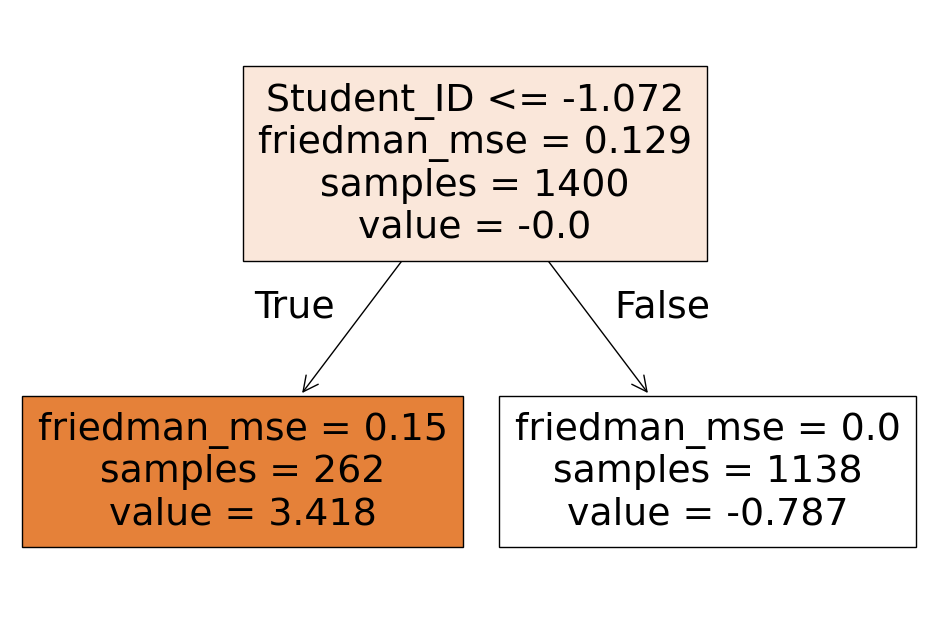

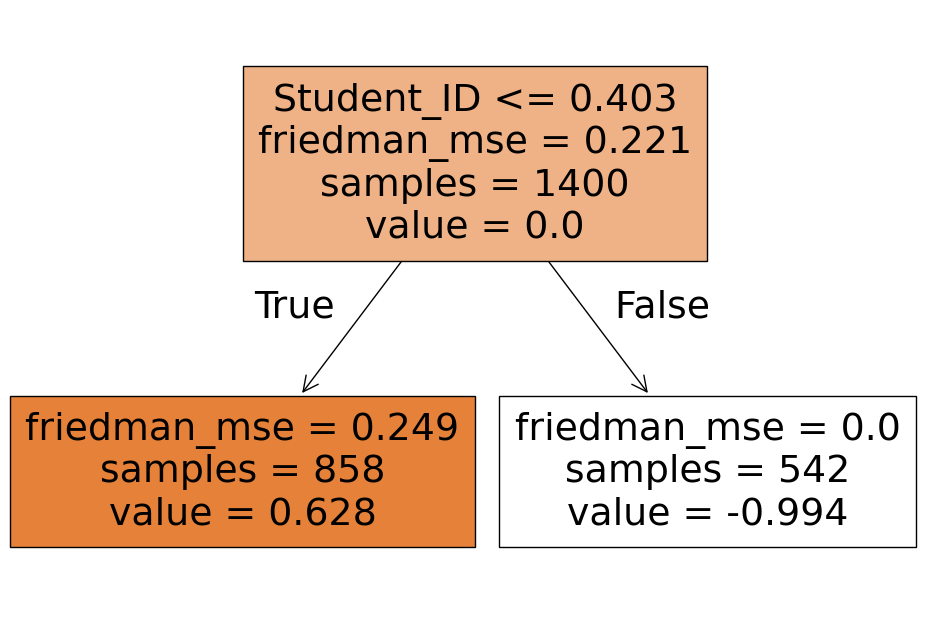

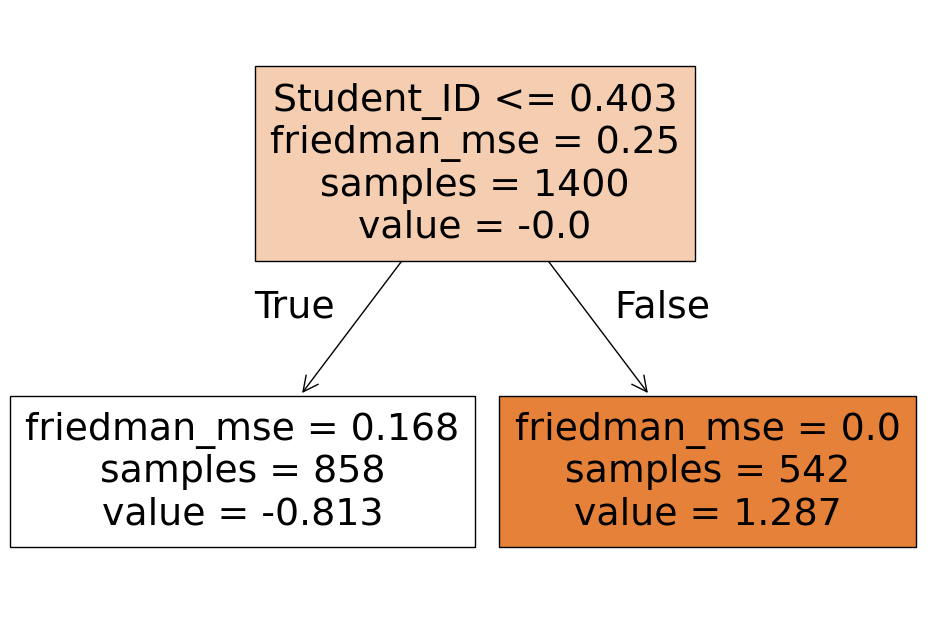

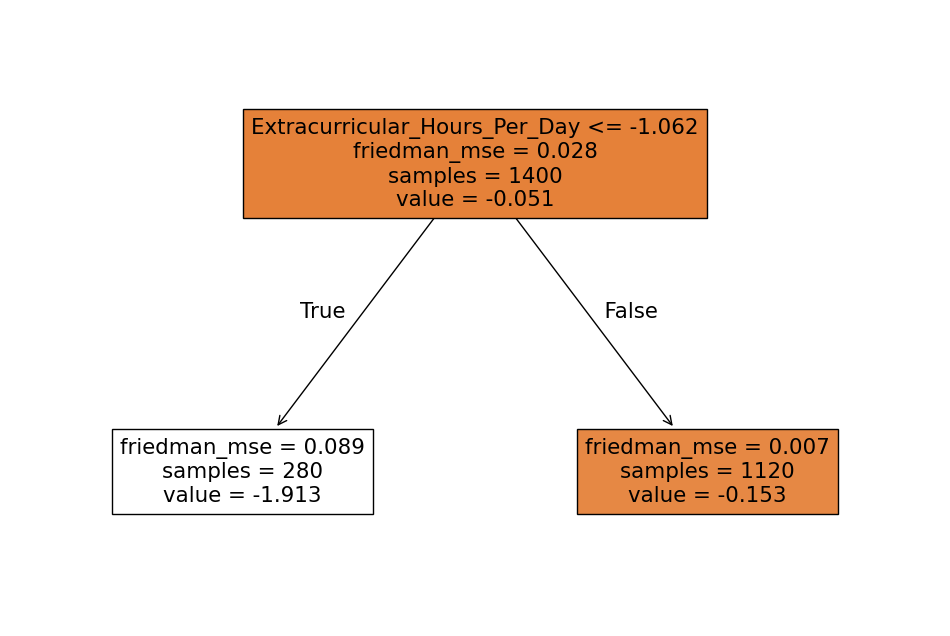

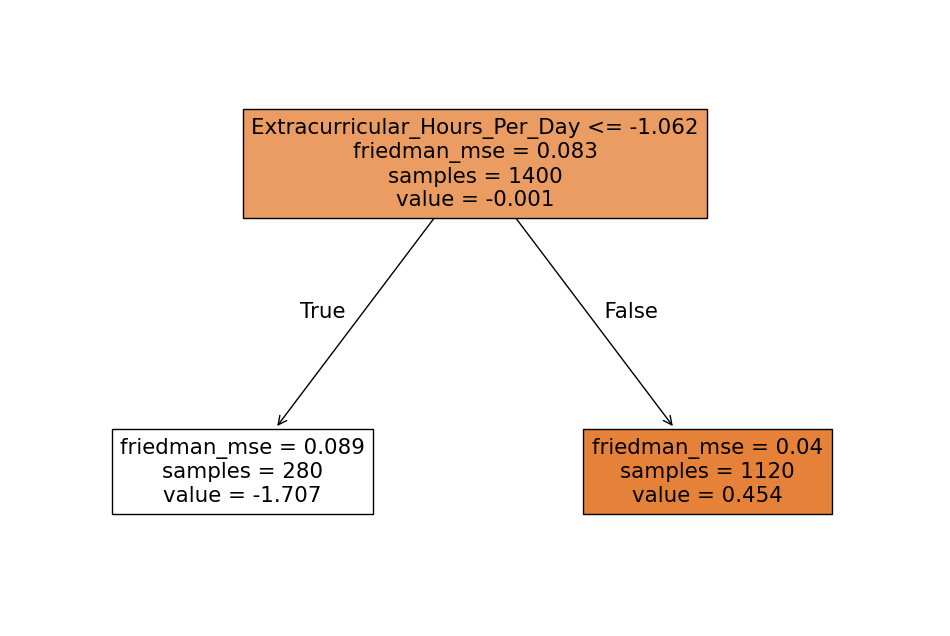

...

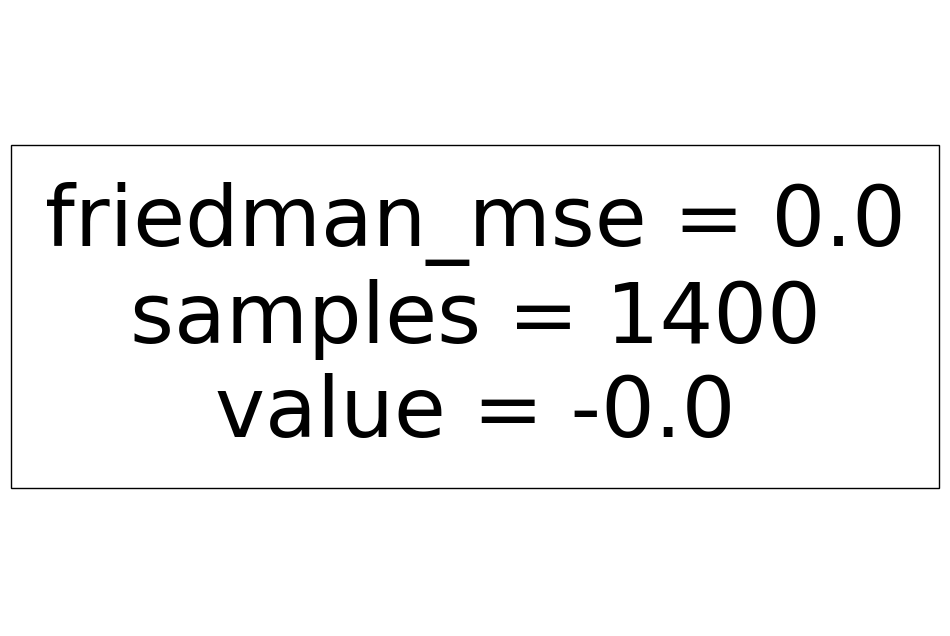

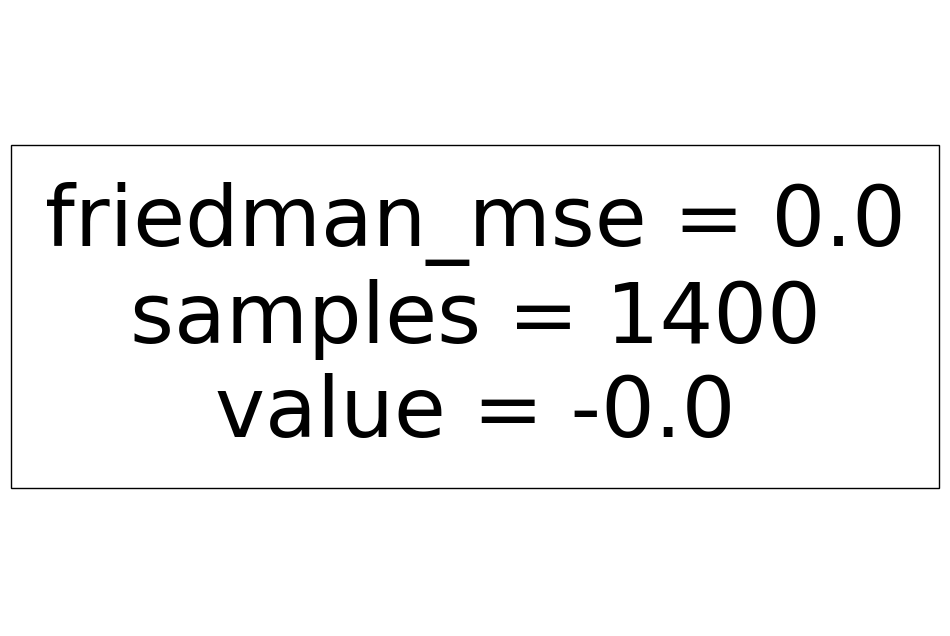

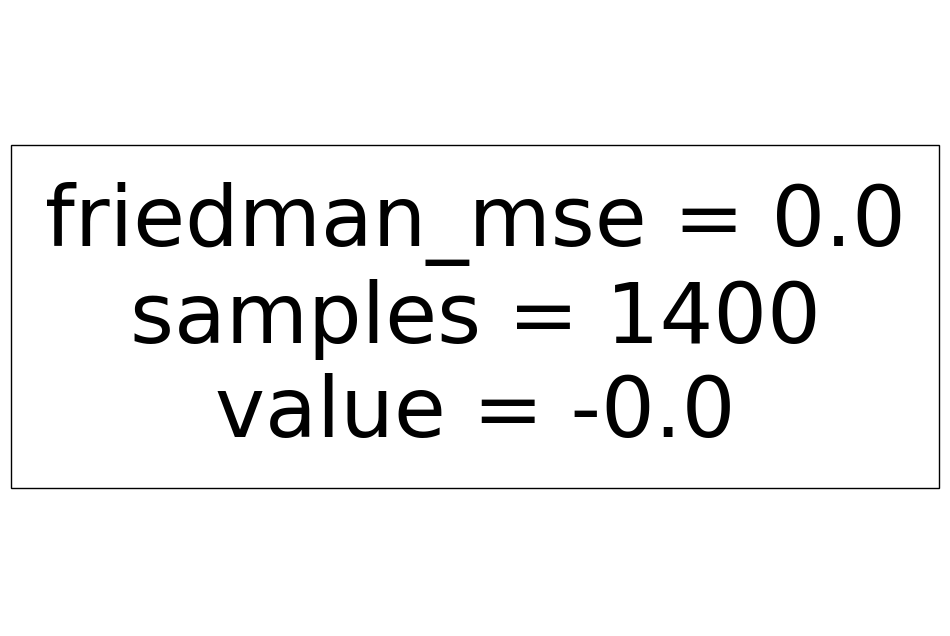

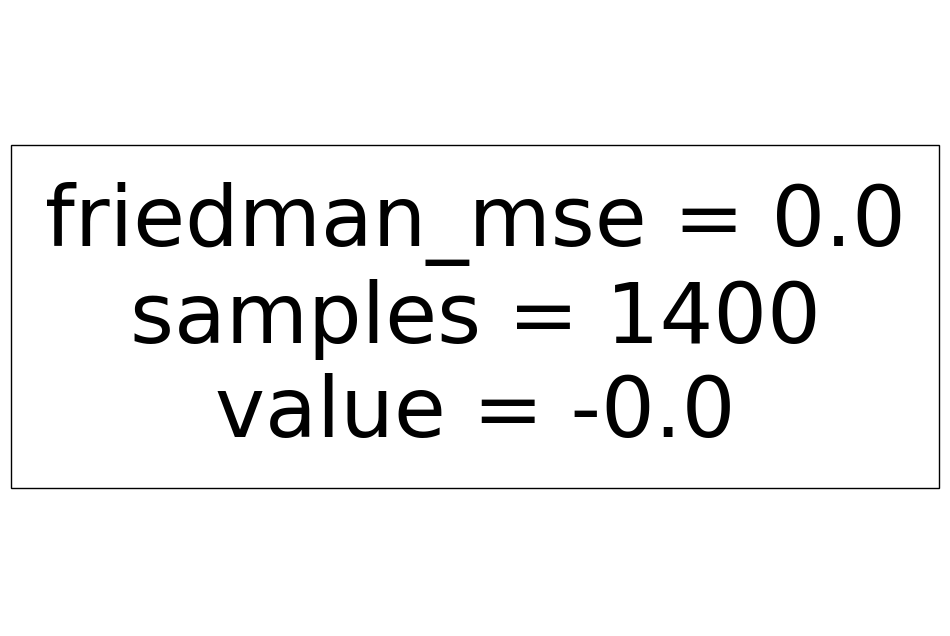

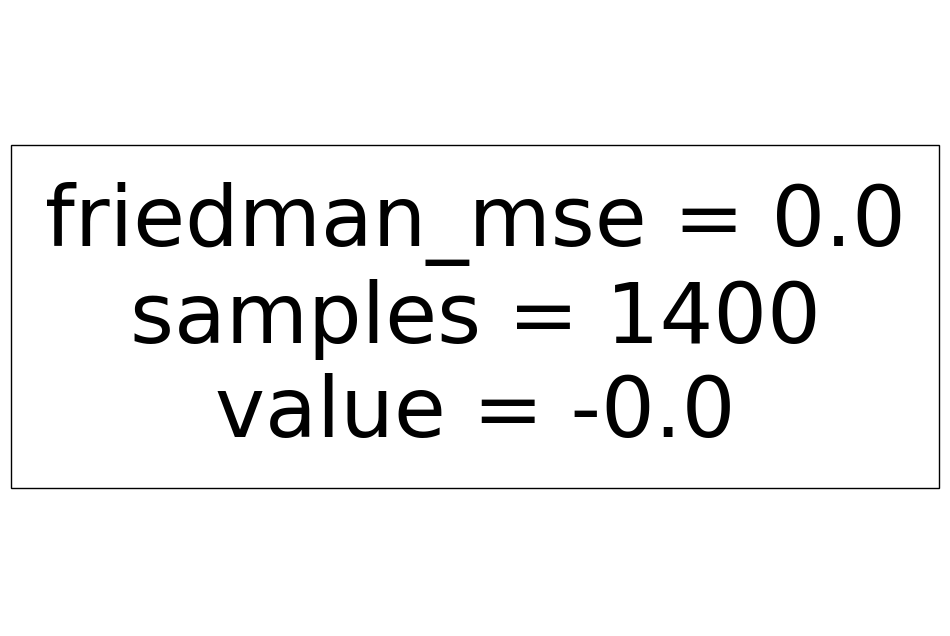

In [38]:
pred = clf.predict(X_test)
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

# Numărul de arbori antrenați (numărul de boosting rounds)
num_trees = clf.estimators_.shape[0]
num_classes = clf.estimators_.shape[1]  # 3 clase: Low, Moderate, High

# Numele claselor pentru etichete
class_names = ['Low', 'Moderate', 'High']

# Parcurgem fiecare iterație de boosting
for i in range(num_trees):
    for j in range(num_classes):  
        tree = clf.estimators_[i, j]  
        
        plt.figure(figsize=(12, 8))
        plt.title(f"Arborele {i + 1} pentru clasa '{class_names[j]}'")
        plot_tree(tree, feature_names=students.columns, filled=True)
        plt.show()


In [40]:
from sklearn.metrics import classification_report,confusion_matrix, accuracy_score


In [42]:
print(confusion_matrix(y_test,pred))
print(accuracy_score(y_test,pred))


[[ 83   0   0]
 [  0 213   0]
 [  0   0 304]]
1.0


In [44]:
print(classification_report(y_test,pred))


              precision    recall  f1-score   support

           1       1.00      1.00      1.00        83
           2       1.00      1.00      1.00       213
           3       1.00      1.00      1.00       304

    accuracy                           1.00       600
   macro avg       1.00      1.00      1.00       600
weighted avg       1.00      1.00      1.00       600

